# The Annotated GAT (PPI)

The idea of this notebook is to explain how you can use GAT on an **inductive example**. 

I'll be using the **PPI (protein-protein interaction) dataset** in this notebook.

Please check out **"The Annotated GAT (Cora)"** notebook for a more gentle introduction to Graph Neural Networks. ❤️

In this notebook you'll get answers to these questions:

✅ How to load and visualize the PPI dataset? <br/>
✅ How to train/use GAT on PPI (multi-label classification problem)? <br/>
✅ How to visualize different GAT's properties? <br/>

Nice, let's start!

---

In [1]:
# I always like to structure my imports into Python's native libs,
# stuff I installed via conda/pip and local file imports (but we don't have those here)

import json

# Visualization related imports
import matplotlib.pyplot as plt
import networkx as nx
from networkx.readwrite import json_graph
import igraph as ig

# Main computation libraries
import numpy as np

# Deep learning related imports
import torch
from torch.utils.data import DataLoader, Dataset

In [2]:
"""
    Contains constants needed for data loading and visualization.

"""

import os
import enum


# Supported datasets - only PPI in this notebook
class DatasetType(enum.Enum):
    PPI = 0

    
class GraphVisualizationTool(enum.Enum):
    IGRAPH = 0


# We'll be dumping and reading the data from this directory
DATA_DIR_PATH = os.path.join(os.getcwd(), 'data')
PPI_PATH = os.path.join(DATA_DIR_PATH, 'ppi')
PPI_URL = 'https://data.dgl.ai/dataset/ppi.zip'  # preprocessed PPI data from Deep Graph Library

#
# PPI specific constants
#

PPI_NUM_INPUT_FEATURES = 50
PPI_NUM_CLASSES = 121

With that out of the way we've got the level 1 unlocked (Data 📜). 😍 Let's go!

# Part 1: Understanding your data (become One with the data 📜❤️)

I'll be using the PPI dataset as the running example in this notebook.

Having said that, you may wonder, what's the difference between `transductive` and `inductive` setting? If you're not familiar with GNNs this may appear as a weird concept. But it's quite simple actually.

**Transductive** - you have a single graph (like Cora) you split some **nodes** (and not graphs) into train/val/test training sets. While you're training you'll be using only the labels from your training nodes. BUT. During the forward prop, by the nature of how spatial GNNs work, you'll be aggregating the feature vectors from your neighbors and **some of them may belong to val or even test sets!** The main point is - you **ARE NOT** using their label information but you **ARE** using the structural information and their features.

**Inductive** - you're probably much more familiar with this one if you come from the computer vision or NLP background. You have a set of training graphs, a separate set of val graphs and of course a separate set of test graphs.

Having explained that let's jump into the code and let's load and visualize PPI.

In [3]:
# First let's define this simple function for loading PPI's graph data

def json_read(path):
    with open(path, 'r') as file:
        data = json.load(file)

    return data

Now let's see how we can load PPI!

In [4]:
def load_graph_data(training_config, device):
    dataset_name = training_config['dataset_name'].lower()
    should_visualize = training_config['should_visualize']

    if dataset_name == DatasetType.PPI.name.lower():  # Protein-Protein Interaction dataset

        # Instead of checking PPI in, I'd rather download it on-the-fly the first time it's needed (lazy execution ^^)
        if not os.path.exists(PPI_PATH):  # download the first time this is ran
            os.makedirs(PPI_PATH)

            # Step 1: Download the ppi.zip (contains the PPI dataset)
            zip_tmp_path = os.path.join(PPI_PATH, 'ppi.zip')
            download_url_to_file(PPI_URL, zip_tmp_path)

            # Step 2: Unzip it
            with zipfile.ZipFile(zip_tmp_path) as zf:
                zf.extractall(path=PPI_PATH)
            print(f'Unzipping to: {PPI_PATH} finished.')

            # Step3: Remove the temporary resource file
            os.remove(zip_tmp_path)
            print(f'Removing tmp file {zip_tmp_path}.')

        # Collect train/val/test graphs here
        edge_index_list = []
        node_features_list = []
        node_labels_list = []

        # Dynamically determine how many graphs we have per split (avoid using constants when possible)
        num_graphs_per_split_cumulative = [0]

        # Small optimization "trick" since we only need test in the playground.py
        splits = ['test'] if training_config['ppi_load_test_only'] else ['train', 'valid', 'test']

        for split in splits:
            # PPI has 50 features per node, it's a combination of positional gene sets, motif gene sets,
            # and immunological signatures - you can treat it as a black box (I personally have a rough understanding)
            # shape = (NS, 50) - where NS is the number of (N)odes in the training/val/test (S)plit
            # Note: node features are already preprocessed
            node_features = np.load(os.path.join(PPI_PATH, f'{split}_feats.npy'))

            # PPI has 121 labels and each node can have multiple labels associated (gene ontology stuff)
            # SHAPE = (NS, 121)
            node_labels = np.load(os.path.join(PPI_PATH, f'{split}_labels.npy'))

            # Graph topology stored in a special nodes-links NetworkX format
            nodes_links_dict = json_read(os.path.join(PPI_PATH, f'{split}_graph.json'))
            # PPI contains undirected graphs with self edges - 20 train graphs, 2 validation graphs and 2 test graphs
            # The reason I use a NetworkX's directed graph is because we need to explicitly model both directions
            # because of the edge index and the way GAT implementation #3 works
            collection_of_graphs = nx.DiGraph(json_graph.node_link_graph(nodes_links_dict))
            # For each node in the above collection, ids specify to which graph the node belongs to
            graph_ids = np.load(os.path.join(PPI_PATH, F'{split}_graph_id.npy'))
            num_graphs_per_split_cumulative.append(num_graphs_per_split_cumulative[-1] + len(np.unique(graph_ids)))

            # Split the collection of graphs into separate PPI graphs
            for graph_id in range(np.min(graph_ids), np.max(graph_ids) + 1):
                mask = graph_ids == graph_id  # find the nodes which belong to the current graph (identified via id)
                graph_node_ids = np.asarray(mask).nonzero()[0]
                graph = collection_of_graphs.subgraph(graph_node_ids)  # returns the induced subgraph over these nodes
                print(f'Loading {split} graph {graph_id} to CPU. '
                      f'It has {graph.number_of_nodes()} nodes and {graph.number_of_edges()} edges.')

                # shape = (2, E) - where E is the number of edges in the graph
                # Note: leaving the tensors on CPU I'll load them to GPU in the training loop on-the-fly as VRAM
                # is a scarcer resource than CPU's RAM and the whole PPI dataset can't fit during the training.
                edge_index = torch.tensor(list(graph.edges), dtype=torch.long).transpose(0, 1).contiguous()
                edge_index = edge_index - edge_index.min()  # bring the edges to [0, num_of_nodes] range
                edge_index_list.append(edge_index)
                # shape = (N, 50) - where N is the number of nodes in the graph
                node_features_list.append(torch.tensor(node_features[mask], dtype=torch.float))
                # shape = (N, 121), BCEWithLogitsLoss doesn't require long/int64 so saving some memory by using float32
                node_labels_list.append(torch.tensor(node_labels[mask], dtype=torch.float))

                if should_visualize:
                    plot_in_out_degree_distributions(edge_index.numpy(), graph.number_of_nodes(), dataset_name)
                    visualize_graph(edge_index.numpy(), node_labels[mask], dataset_name)

        #
        # Prepare graph data loaders
        #

        # Optimization, do a shortcut in case we only need the test data loader
        if training_config['ppi_load_test_only']:
            data_loader_test = GraphDataLoader(
                node_features_list[num_graphs_per_split_cumulative[0]:num_graphs_per_split_cumulative[1]],
                node_labels_list[num_graphs_per_split_cumulative[0]:num_graphs_per_split_cumulative[1]],
                edge_index_list[num_graphs_per_split_cumulative[0]:num_graphs_per_split_cumulative[1]],
                batch_size=training_config['batch_size'],
                shuffle=False
            )
            return data_loader_test
        else:

            data_loader_train = GraphDataLoader(
                node_features_list[num_graphs_per_split_cumulative[0]:num_graphs_per_split_cumulative[1]],
                node_labels_list[num_graphs_per_split_cumulative[0]:num_graphs_per_split_cumulative[1]],
                edge_index_list[num_graphs_per_split_cumulative[0]:num_graphs_per_split_cumulative[1]],
                batch_size=training_config['batch_size'],
                shuffle=True
            )

            data_loader_val = GraphDataLoader(
                node_features_list[num_graphs_per_split_cumulative[1]:num_graphs_per_split_cumulative[2]],
                node_labels_list[num_graphs_per_split_cumulative[1]:num_graphs_per_split_cumulative[2]],
                edge_index_list[num_graphs_per_split_cumulative[1]:num_graphs_per_split_cumulative[2]],
                batch_size=training_config['batch_size'],
                shuffle=False  # no need to shuffle the validation and test graphs
            )

            data_loader_test = GraphDataLoader(
                node_features_list[num_graphs_per_split_cumulative[2]:num_graphs_per_split_cumulative[3]],
                node_labels_list[num_graphs_per_split_cumulative[2]:num_graphs_per_split_cumulative[3]],
                edge_index_list[num_graphs_per_split_cumulative[2]:num_graphs_per_split_cumulative[3]],
                batch_size=training_config['batch_size'],
                shuffle=False
            )

            return data_loader_train, data_loader_val, data_loader_test
    else:
        raise Exception(f'{dataset_name} not yet supported.')

Nice, there are is this `GraphDataLoader` object we still haven't defined. Let's go and do it!

In [5]:
class GraphDataLoader(DataLoader):
    """
    When dealing with batches it's always a good idea to inherit from PyTorch's provided classes (Dataset/DataLoader).

    """
    def __init__(self, node_features_list, node_labels_list, edge_index_list, batch_size=1, shuffle=False):
        graph_dataset = GraphDataset(node_features_list, node_labels_list, edge_index_list)
        # We need to specify a custom collate function, it doesn't work with the default one
        super().__init__(graph_dataset, batch_size, shuffle, collate_fn=graph_collate_fn)


class GraphDataset(Dataset):
    """
    This one just fetches a single graph from the split when GraphDataLoader "asks" it

    """
    def __init__(self, node_features_list, node_labels_list, edge_index_list):
        self.node_features_list = node_features_list
        self.node_labels_list = node_labels_list
        self.edge_index_list = edge_index_list

    # 2 interface functions that need to be defined are len and getitem so that DataLoader can do it's magic
    def __len__(self):
        return len(self.edge_index_list)

    def __getitem__(self, idx):  # we just fetch a single graph
        return self.node_features_list[idx], self.node_labels_list[idx], self.edge_index_list[idx]


def graph_collate_fn(batch):
    """
    The main idea here is to take multiple graphs from PPI as defined by the batch size
    and merge them into a single graph with multiple connected components.

    It's important to adjust the node ids in edge indices such that they form a consecutive range. Otherwise
    the scatter functions in the implementation 3 will fail.

    :param batch: contains a list of edge_index, node_features, node_labels tuples (as provided by the GraphDataset)
    """

    edge_index_list = []
    node_features_list = []
    node_labels_list = []
    num_nodes_seen = 0

    for features_labels_edge_index_tuple in batch:
        # Just collect these into separate lists
        node_features_list.append(features_labels_edge_index_tuple[0])
        node_labels_list.append(features_labels_edge_index_tuple[1])

        edge_index = features_labels_edge_index_tuple[2]  # all of the components are in the [0, N] range
        edge_index_list.append(edge_index + num_nodes_seen)  # very important! translate the range of this component
        num_nodes_seen += len(features_labels_edge_index_tuple[1])  # update the number of nodes we've seen so far

    # Merge the PPI graphs into a single graph with multiple connected components
    node_features = torch.cat(node_features_list, 0)
    node_labels = torch.cat(node_labels_list, 0)
    edge_index = torch.cat(edge_index_list, 1)

    return node_features, node_labels, edge_index

Nice, finally let's try and load it. We should also analyze the shapes - that's always a good idea.

In [7]:
# Let's just define dummy visualization functions for now - just to stop Python interpreter from complaining!
# We'll define them in a moment, properly, I swear.

def plot_in_out_degree_distributions():
    pass

def visualize_graph():
    pass

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # checking whether you have a GPU

config = {
    'dataset_name': DatasetType.PPI.name,
    'should_visualize': False,
    'batch_size': 1,
    'ppi_load_test_only': False  # small optimization for loading test only here we won't use it
}

data_loader_train, data_loader_val, data_loader_test = load_graph_data(config, device)
# Let's fetch a single batch from the train graph data loader
node_features, node_labels, edge_index = next(iter(data_loader_train))

print('*' * 20)
print(node_features.shape, node_features.dtype)
print(node_labels.shape, node_labels.dtype)
print(edge_index.shape, edge_index.dtype)

Loading train graph 1 to CPU. It has 1767 nodes and 34085 edges.
Loading train graph 2 to CPU. It has 1377 nodes and 31081 edges.
Loading train graph 3 to CPU. It has 2263 nodes and 61907 edges.
Loading train graph 4 to CPU. It has 2339 nodes and 67769 edges.
Loading train graph 5 to CPU. It has 1578 nodes and 37740 edges.
Loading train graph 6 to CPU. It has 1021 nodes and 19237 edges.
Loading train graph 7 to CPU. It has 1823 nodes and 46153 edges.
Loading train graph 8 to CPU. It has 2488 nodes and 72878 edges.
Loading train graph 9 to CPU. It has 591 nodes and 8299 edges.
Loading train graph 10 to CPU. It has 3312 nodes and 109510 edges.
Loading train graph 11 to CPU. It has 2401 nodes and 66619 edges.
Loading train graph 12 to CPU. It has 1878 nodes and 48146 edges.
Loading train graph 13 to CPU. It has 1819 nodes and 47587 edges.
Loading train graph 14 to CPU. It has 3480 nodes and 110234 edges.
Loading train graph 15 to CPU. It has 2794 nodes and 88112 edges.
Loading train graph

Nice! Analyzing the shapes we see the following:
1. This specific PPI train graph (batch size = 1) has 3312 nodes 
2. Each node has 50 features (check out [data_loading.py](https://github.com/gordicaleksa/pytorch-GAT/blob/main/utils/data_loading.py) for much more detail)
3. PPI has 121 classes and each node can have multiple classes associated with it (multi-label classification dataset)
3. This graph has 109510 edges (including the self edges)! (Compare this to 13k edges in Cora)

Additionally the edge index is of `int 64` type. Why? Well it's a constraint that PyTorch is imposing upon us. `index_select` functions require torch.long (i.e. 64 bit integer) and we use those in GAT implementation 3 - that's it.

node_labels can be `float32` because `nn.BCEWithLogitsLoss` doesn't require long/int64 type (contrast that to `nn.CrossEntropyLoss` which does require int64s). So we can save up 2x memory!

On the "side note", it's always a **good idea to test your code as you're progressing.** 

Data loading is completely orthogonal to the rest of this notebook so we can test it, standalone, and make sure the shapes and datatypes make sense. I use this strategy while developing projects like this one (and in general).

I start with data, I add the loading functionality, I add some visualizations and only then do I usually start developing the deep learning model itself.

Visualizations are a huge bonus, so let's develop them.

# Visualizing your data 🔮👓

Let's start by understanding the degree distribution of nodes in PPI - i.e. how many input/output edges do nodes have, a certain measure of connectedness of the graph.

Run the following cell:

In [8]:
def plot_in_out_degree_distributions(edge_index, num_of_nodes, dataset_name):
    """
        Note: It would be easy to do various kinds of powerful network analysis using igraph/networkx, etc.
        I chose to explicitly calculate only the node degree statistics here, but you can go much further if needed and
        calculate the graph diameter, number of triangles and many other concepts from the network analysis field.

    """
    if isinstance(edge_index, torch.Tensor):
        edge_index = edge_index.cpu().numpy()
        
    assert isinstance(edge_index, np.ndarray), f'Expected NumPy array got {type(edge_index)}.'

    # Store each node's input and output degree (they're the same for undirected graphs such as Cora)
    in_degrees = np.zeros(num_of_nodes, dtype=np.int)
    out_degrees = np.zeros(num_of_nodes, dtype=np.int)

    # Edge index shape = (2, E), the first row contains the source nodes, the second one target/sink nodes
    # Note on terminology: source nodes point to target/sink nodes
    num_of_edges = edge_index.shape[1]
    for cnt in range(num_of_edges):
        source_node_id = edge_index[0, cnt]
        target_node_id = edge_index[1, cnt]

        out_degrees[source_node_id] += 1  # source node points towards some other node -> increment it's out degree
        in_degrees[target_node_id] += 1  # similarly here

    hist = np.zeros(np.max(out_degrees) + 1)
    for out_degree in out_degrees:
        hist[out_degree] += 1

    fig = plt.figure(figsize=(12,8), dpi=100)  # otherwise plots are really small in Jupyter Notebook
    fig.subplots_adjust(hspace=0.6)

    plt.subplot(311)
    plt.plot(in_degrees, color='red')
    plt.xlabel('node id'); plt.ylabel('in-degree count'); plt.title('Input degree for different node ids')

    plt.subplot(312)
    plt.plot(out_degrees, color='green')
    plt.xlabel('node id'); plt.ylabel('out-degree count'); plt.title('Out degree for different node ids')

    plt.subplot(313)
    plt.plot(hist, color='blue')
    plt.xlabel('node degree'); plt.ylabel('# nodes for a given out-degree'); plt.title(f'Node out-degree distribution for {dataset_name} dataset')
    plt.xticks(np.arange(0, len(hist), 20.0))

    plt.grid(True)
    plt.show()

Brilliant, let's now visualize PPI's degree distributions!

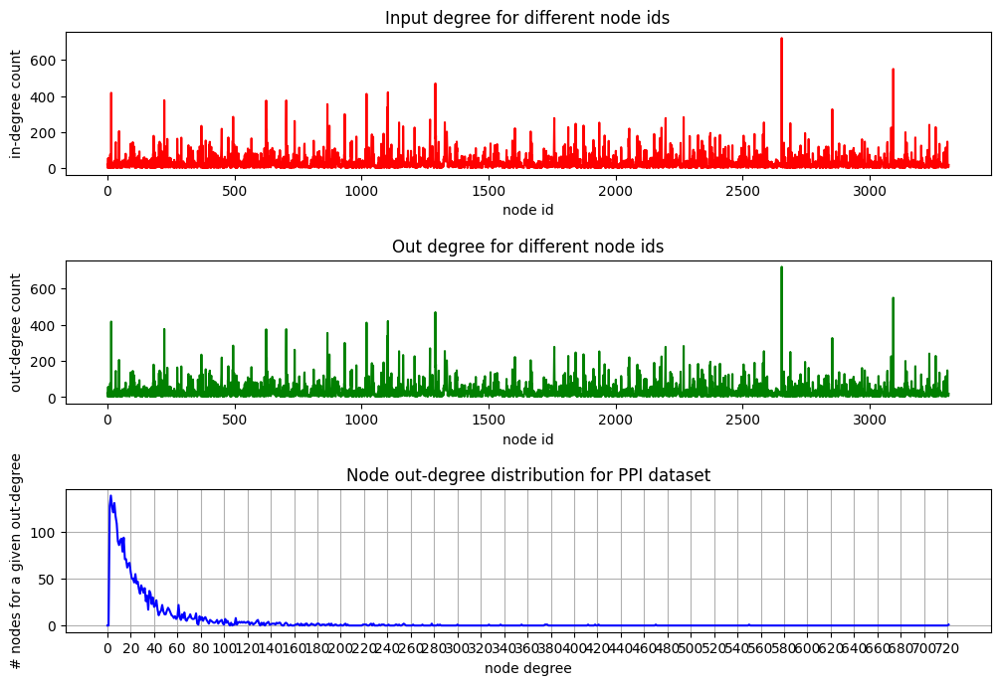

In [9]:
num_of_nodes = len(node_labels)
plot_in_out_degree_distributions(edge_index, num_of_nodes, config['dataset_name'])

You can immediately notice a couple of things:
* The top 2 plots are the same, because we treat PPI as an undirected graph
* Many more nodes have a large number of edges (compared to Cora) but still the most nodes have far less edges
* The third plot nicely visualizes this in the form of a histogram - most nodes have only `2-20` edges (hence the peak on the leftmost side). But it's more spread than Cora's plot.

Ok, we're starting to get some valuable insight into PPI, let's continue further and literally visualize/see PPI's graphs.

The following cell will plot the training graph we fetched in one of the previous cells, run it. (*whispers: run it*)

In [10]:
"""
Check out this blog for available graph visualization tools:
    https://towardsdatascience.com/large-graph-visualization-tools-and-approaches-2b8758a1cd59

Basically depending on how big your graph is there may be better drawing tools than igraph.

Note: I unfortunatelly had to flatten this function since igraph is having some problems with Jupyter Notebook,
we'll only call it here so it's fine!

"""

dataset_name = config['dataset_name']
visualization_tool=GraphVisualizationTool.IGRAPH

if isinstance(edge_index, torch.Tensor):
    edge_index_np = edge_index.cpu().numpy()

if isinstance(node_labels, torch.Tensor):
    node_labels_np = node_labels.cpu().numpy()

num_of_nodes = len(node_labels_np)
edge_index_tuples = list(zip(edge_index_np[0, :], edge_index_np[1, :]))  # igraph requires this format

# Construct the igraph graph
ig_graph = ig.Graph()
ig_graph.add_vertices(num_of_nodes)
ig_graph.add_edges(edge_index_tuples)

# Prepare the visualization settings dictionary
visual_style = {}

# Defines the size of the plot and margins
# go berserk here try (3000, 3000) it looks amazing in Jupyter!!! (you'll have to adjust the vertex_size though!)
visual_style["bbox"] = (600, 600)
visual_style["margin"] = 5

# I've chosen the edge thickness such that it's proportional to the number of shortest paths (geodesics)
# that go through a certain edge in our graph (edge_betweenness function, a simple ad hoc heuristic)

# line1: I use log otherwise some edges will be too thick and others not visible at all
# edge_betweeness returns < 1 for certain edges that's why I use clip as log would be negative for those edges
# line2: Normalize so that the thickest edge is 1 otherwise edges appear too thick on the chart
# line3: The idea here is to make the strongest edge stay stronger than others, 6 just worked, don't dwell on it

edge_weights_raw = np.clip(np.log(np.asarray(ig_graph.edge_betweenness())+1e-16), a_min=0, a_max=None)
edge_weights_raw_normalized = edge_weights_raw / np.max(edge_weights_raw)
edge_weights = [w**6 for w in edge_weights_raw_normalized]
visual_style["edge_width"] = edge_weights

# A simple heuristic for vertex size. Size ~ (degree / 4) (it gave nice results I tried log and sqrt as well)
visual_style["vertex_size"] = [deg / 10 for deg in ig_graph.degree()]

# Set the layout - the way the graph is presented on a 2D chart. Graph drawing is a subfield for itself!
# I used "Kamada Kawai" a force-directed method, this family of methods are based on physical system simulation.
# (layout_drl also gave nice results for Cora)
visual_style["layout"] = ig_graph.layout_kamada_kawai()

print('Plotting results ... (it may take couple of seconds).')
ig.plot(ig_graph, **visual_style)

# This website has got some awesome visualizations check it out:
# http://networkrepository.com/graphvis.php?d=./data/gsm50/labeled/cora.edges

Plotting results ... (it may take couple of seconds).


I don't know about you, but I think this one is also beautiful! And it's way more different compared to Cora.

Ok we're done with visualizations and understanding our data. This is a huge milestone, so tap yourself on the back. 🏆🎂🎵

We have the level 2 unlocked (the GAT model 🦄). 😍

And now, let's understand the model! (again, or just skip it (run the cells blindly) if you only came for PPI-specific stuff)